# Equations of Motion Formulation of a Pendulum Containing N-point Masses

This project is implimentation of reserach paper by `Boran Yesilyurt`

`General overview`: A general formulation of equations of motion of a
pendulum with $n$ point mass by use of two different methods. The first one is
obtained by using Lagrange Mechanics and mathematical induction(inspection), and
the second one is derived by defining a vector. Study gives a very compact form
of these equations that is more eﬃcient than solving `Euler-Lagrange Equations` for
every pendulum with more complex structures than simple or double pendulum.
Additionally, we investigate what will happen to our n-point mass system when we
take limit as number of point masses goes inﬁnity under well-deﬁned assumptions. 
We ﬁnd out that it converges to hanging rope system.

## 1. Simple and double pendulum

In [1]:
# Importing libraries
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
from sympy import symbols, Function, sin, cos, diff, Derivative, latex, Eq, pprint
from sympy import solve, dsolve, simplify, expand, integrate
from sympy import latex
from IPython.display import display, Math

###  Ploting 2D pendulum

In [3]:
# Define the symbols
t_latex = symbols('t')  # time
g_latex, L_latex, m_latex = symbols('g L m')  # constants: gravity, length, mass
x1_latex, y1_latex, x2_latex, y2_latex = symbols('x1 y1 x2 y2')  # coordinates of the pendulum

# Define the functions
theta_latex = Function('theta')(t_latex)  # angle as a function of time
theta_dot_latex = Derivative(theta_latex, t_latex)
theta_ddot_latex = Derivative(theta_latex, t_latex, t_latex)

omega_latex = Function('omega')(t_latex)  # angular velocity as a function of time
omega_dot_latex = Derivative(omega_latex, t_latex)

# Display the symbols
display(Math(latex(g_latex)))
display(Math(latex(L_latex)))
display(Math(latex(m_latex)))

display(Math(latex(theta_latex)))
display(Math(latex(theta_dot_latex)))
display(Math(latex(theta_ddot_latex)))

display(Math(latex(omega_dot_latex)))
display(Math(latex(omega_dot_latex)))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [4]:
display(Math(r'\text{The equations of motion for the pendulum are given by:}'))
eq1 = Eq(omega_dot_latex, - (g_latex / L_latex) * theta_latex)
eq2 = Eq(theta_dot_latex, omega_latex)

display(eq1)
display(eq2)

<IPython.core.display.Math object>

Eq(Derivative(omega(t), t), -g*theta(t)/L)

Eq(Derivative(theta(t), t), omega(t))

### Ploting 2D pendulum

In [5]:
# Constants
g = 9.8  # acceleration due to gravity
L = 1.0  # length of the pendulum
m = 1.0  # mass of the pendulum
theta_0 = np.pi / 4  # initial displacement in radians for the first pendulum
theta_1 = np.pi / 6  # initial displacement in radians for the second pendulum
theta_2 = np.pi / 8  # initial displacement in radians for the third pendulum

# Coordinates of the first pendulum bob
x1 = L * np.sin(theta_0)
y1 = -L * np.cos(theta_0)

# Coordinates of the second pendulum bob
x2 = x1 + L * np.sin(theta_1)
y2 = y1 - L * np.cos(theta_1)

# Coordinates of the third pendulum bob
x3 = x2 + L * np.sin(theta_2)
y3 = y2 - L * np.cos(theta_2)


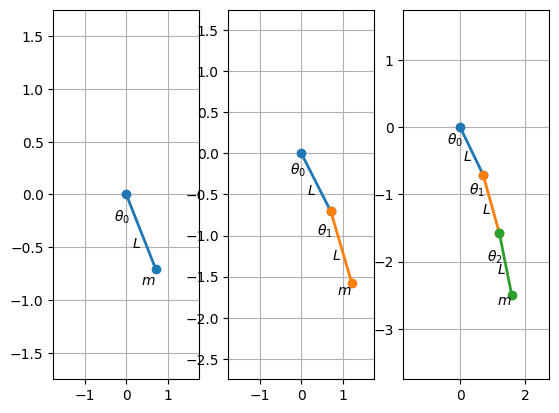

In [6]:
# Create the plot
fig, ax = plt.subplots(1,3)

# Plot for the first pendulum
ax[0].grid()
ax[0].plot([0, x1], [0, y1], 'o-', lw=2)
ax[0].text(0.1, -0.25, r'$\theta_0$', fontsize=10, ha='right')
ax[0].text(x1, y1-0.15, r'$m$', fontsize=10, ha='right')
ax[0].text(x1 / 2, y1 / 2 - 0.15, r'$L$', fontsize=10, ha='right')
ax[0].set_xlim(-1.75, 1.75)
ax[0].set_ylim(-1.75, 1.75)

# Plot for the second pendulum
ax[1].grid()
ax[1].plot([0, x1], [0, y1], 'o-', lw=2)
ax[1].plot([x1, x2], [y1, y2], 'o-', lw=2)
ax[1].text(0.1, -0.25, r'$\theta_0$', fontsize=10, ha='right')
ax[1].text(0.75, -1, r'$\theta_1$', fontsize=10, ha='right')
ax[1].text(x2, y2-0.15, r'$m$', fontsize=10, ha='right')
ax[1].text(x1 / 2, y1 / 2 - 0.15, r'$L$', fontsize=10, ha='right')
ax[1].text((x1+x2)/ 2, (y1+y2) / 2 - 0.15, r'$L$', fontsize=10, ha='right')
ax[1].set_xlim(-1.75, 1.75)
ax[1].set_ylim(-2.75, 1.75)

# Plot for the third pendulum
ax[2].grid()
ax[2].plot([0, x1], [0, y1], 'o-', lw=2)
ax[2].plot([x1, x2], [y1, y2], 'o-', lw=2)
ax[2].plot([x2, x3], [y2, y3], 'o-', lw=2)
ax[2].text(0.1, -0.25, r'$\theta_0$', fontsize=10, ha='right')
ax[2].text(0.75, -1, r'$\theta_1$', fontsize=10, ha='right')
ax[2].text(1.3, -2, r'$\theta_2$', fontsize=10, ha='right')
ax[2].text(x3, y3-0.15, r'$m$', fontsize=10, ha='right')
ax[2].text(x1 / 2, y1 / 2 - 0.15, r'$L$', fontsize=10, ha='right')
ax[2].text((x1+x2)/ 2, (y1+y2) / 2 - 0.15, r'$L$', fontsize=10, ha='right')
ax[2].text((x2+x3)/ 2, (y2+y3) / 2 - 0.15, r'$L$', fontsize=10, ha='right')
ax[2].set_xlim(-1.75, 2.75)
ax[2].set_ylim(-3.75, 1.75)

plt.show()

## Animating 2D pendulum

In [7]:
# Time
t_max = 10  # total time to simulate
dt = 0.01  # time step
t = np.arange(0, t_max, dt)

# Variables to hold angle and angular velocity
theta = np.zeros_like(t)
omega = np.zeros_like(t)

# Set initial conditions
theta[0] = theta_0
omega[0] = 0

In [8]:
# Euler's method
for i in range(len(t) - 1):
    omega[i + 1] = omega[i] - (g / L) * theta[i] * dt
    theta[i + 1] = theta[i] + omega[i] * dt

Animation size has reached 20989069 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


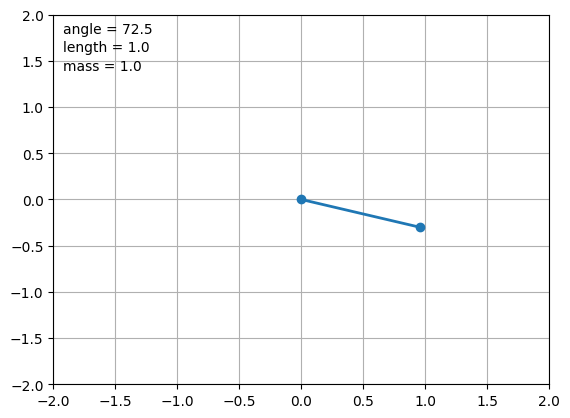

In [9]:
# Plotting
fig, ax = plt.subplots()
plt.grid()
line, = ax.plot([], [], 'o-', lw=2)
ax.set_ylim([-2, 2])
ax.set_xlim([-2, 2])

# Text objects for displaying the angle, length, and mass
angle_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)
length_text = ax.text(0.02, 0.90, '', transform=ax.transAxes)
mass_text = ax.text(0.02, 0.85, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    angle_text.set_text('')
    length_text.set_text('')
    mass_text.set_text('')
    return line, angle_text, length_text, mass_text

def animate(i):
    x = [0, np.sin(theta[i])]
    y = [0, -np.cos(theta[i])]

    line.set_data(x, y)
    angle_text.set_text('angle = %.1f' % (theta[i] * 180 / np.pi))  # convert radian to degree
    length_text.set_text('length = %.1f' % L)
    mass_text.set_text('mass = %.1f' % m)
    return line, angle_text, length_text, mass_text

ani = animation.FuncAnimation(fig, animate, frames=len(t), init_func=init, blit=True)

# Display the animation
HTML(ani.to_jshtml())

# $1^{st}$ way of derivation

Consider the Lagrangian and equations of motion of simple pendulum and double pendulum.

According to eq.1, the equation of motion for a pendulum is given by:

$$
\ddot{\theta} + \frac{g}{l} \sin(\theta) = 0
$$

The Lagrangian L, which is the difference between the kinetic energy T and the potential energy U, is given by:

$$
L = T - U = \frac{1}{2} m l^2 \dot{\theta}^2 - mgl \cos(\theta)
$$

where:
- $\theta$ is the angle of the pendulum,
- $g$ is the acceleration due to gravity,
- $l$ is the length of the pendulum,
- $m$ is the mass of the pendulum,
- $\dot{\theta}$ is the angular velocity, and
- $\ddot{\theta}$ is the angular acceleration.

In [10]:
# Define the equations
eq_motion = Eq(theta_ddot_latex + g_latex/L_latex * sin(theta_latex), 0)
Lagrangian = 1/2 * m_latex * L_latex**2 * diff(theta_latex, t_latex)**2 - m_latex * g_latex * L_latex* cos(theta_latex)

# Display the equations
print("Equation of motion:")
display(eq_motion)
print("Lagrangian:")
display(Lagrangian)

Equation of motion:


Eq(Derivative(theta(t), (t, 2)) + g*sin(theta(t))/L, 0)

Lagrangian:


0.5*L**2*m*Derivative(theta(t), t)**2 - L*g*m*cos(theta(t))

In [11]:
# Constants
g = 9.8  # acceleration due to gravity
L = 1.0  # length of the pendulum
m = 1.0  # mass of the pendulum

# Time
t_max = 10  # total time to simulate
dt = 0.01  # time step
t = np.arange(0, t_max, dt)

# Variables to hold angle and angular velocity
theta = np.zeros_like(t)
omega = np.zeros_like(t)

# Set initial conditions
theta[0] = theta_0
omega[0] = 0

In [12]:
# Euler's method
for i in range(len(t) - 1):
    omega[i + 1] = omega[i] - (g / L) * float(theta[i]) * dt
    theta[i + 1] = theta[i] + omega[i] * dt

In [13]:
# Variables to hold the Lagrangian
Lag = np.zeros_like(t)

# Euler's method
for i in range(len(t) - 1):
    omega[i + 1] = omega[i] - (g / L) * np.sin(theta[i]) * dt
    theta[i + 1] = theta[i] + omega[i] * dt

    # Calculate the kinetic energy T and the potential energy U
    T = 0.5 * m * L**2 * omega[i]**2
    U = m * g * L * np.cos(theta[i])

    # Calculate the Lagrangian L
    Lag[i] = T - U

In [14]:
# Define the equations
eq_motion = Eq(diff(theta_latex, t_latex, t_latex) + g_latex/L_latex * sin(theta_latex), 0)
Lagrangian = 0.5 * m_latex * L_latex**2 * diff(theta_latex, t_latex)**2 - m_latex * g_latex * L_latex * cos(theta_latex)

# Display the equations with LaTeX formatting
display(Math("Equation of motion: " + latex(eq_motion)))
display(Math("Lagrangian: " + latex(Lagrangian)))

<IPython.core.display.Math object>

<IPython.core.display.Math object>